# EXECUTE THE CELL BELOW ONLY IF YOU'RE WORKING IN GOOGLE COLAB! 

In [1]:
# Execute the cell only ONCE

!git clone https://gitflic.ru/project/aidynamicaction/classedu2023-advctrl.git
%cd /content/classedu2023-advctrl/assignments/asgn-2

[WinError 3] Системе не удается найти указанный путь: '/content/classedu2023-advctrl/assignments/asgn-2'
c:\Users\serge\Desktop\classedu2023-advctrl\assignments\asgn-2


Cloning into 'classedu2023-advctrl'...


# Introduction
In this assignment, you will learn how to design a controller that stabilizes a cartpole making it swing up and hold the pole in vertical position.
It's strongly recommended for you to familiarize yourself with [README](../README.md) in `assignments` folder before starting to work on your tasks.  

# Background

## Definition of cartpole system

<img style="right;" src="cartpole.svg" width=18% height=18%>

Our cartpole can be represented by a controlled system 
$$
\begin{cases}
    \ddot{\theta} = \frac{g}{l}\sin{\theta} - \ddot{x}\frac{\cos(\theta)}{l} \\
    \ddot{x} = \frac{
        -m_p g \cos(\theta) \sin(\theta)
        + m_p  l  \dot{\theta}^2  \sin(\theta)
        + U_t
     }{m_c + m_p  \sin(\theta) ^ 2}
\end{cases}
\quad 
\text{where $U_t$ is control input}
$$

**The goal of the controller is to stabilize the pole into the origin by angle:** $\boldsymbol x_{\text{origin}} := (0, *)$


Energy reads: $\frac{m_p l^2 \dot{\theta}^2}{2} - m_p g l (\cos \theta - 1)$ (We neglect kinetic energy of cart)

In [2]:
# Execute the cell only ONCE
# Restart runtime RIGHT AFTER the cell is finished. It may fail with error --- do not mind
%pip install -e src

Obtaining file:///C:/Users/serge/Desktop/classedu2023-advctrl/assignments/asgn-2/src
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached matplotlib-3.6.3-cp39-cp39-win_amd64.whl (7.2 MB)
  Using cached mpldatacursor_rcognita-0.7.2-py3-none-any.whl
  Using cached numpy-1.24.3-cp39-cp39-win_amd64.whl (14.9 MB)
  Using cached scipy-1.10.1-cp39-cp39-win_amd64.whl (42.5 MB)
  Using cached svgpath2mpl-0.2.1-py2.py3-none-any.whl (7.4 kB)
  Using cached tabulate-0.9.0-py3-none-any.whl (35 kB)
  Using cached systems-0.1.0-py3-none-any.whl (16 kB)
  Using cached Shapely-1.7.1-cp39-cp39-win_amd64.whl (978 kB)
  Using cached tabulate-0.8.7-py3-none-any.whl (24 kB)
  Using cached recursive_monkey_patch-0.4.0-py2.py3-none-any.whl (8.6 kB)
  Using cached omegaconf-2.3.0-py3-none-any.whl (79 kB)
  Using cached hydra_core-1.3.2-py3-none-any.whl (154 kB)
  Using cached hydra_joblib_launcher-1.2.0-py3-none-any.whl (5.2 kB)
  Using cached pa

You should consider upgrading via the 'c:\Users\serge\Desktop\classedu2023-advctrl\assignments\asgn-2\asgn-2_venv\Scripts\python.exe -m pip install --upgrade pip' command.


In [2]:
from rcognita.__utilities import rc, Clock
from rcognita.visualization import dashboards
from rcognita.models import ModelQuadForm
import rcognita.__utilities as utilities
from rcognita.systems import System
from rcognita.controllers import Controller
from rcognita.testing_pipeline import create_testing_pipeline
from rcognita.adaptation_blocks import AdaptationBlock
import numpy as np
from matplotlib import rc as rc_params
rc_params("animation", html="jshtml")


In [3]:
def apply_action_bounds(method):
    def wrapper(self, *args, **kwargs):
        self.action = method(self, *args, **kwargs)
        if hasattr(self, "action_bounds") and self.action_bounds != []:
            action = np.clip(
                self.action, self.action_bounds[:, 0], self.action_bounds[:, 1]
            )
            self.action = action
        return self.action

    return wrapper

## Cartpole system

------------

Complete the code for class of system to fill `Dstate` vector inside `compute_dynamics` method.

$$
\begin{cases}
    \ddot{\theta} = \frac{g}{l}\sin{\theta} - \ddot{x}\frac{\cos(\theta)}{l} \\ 
    \ddot{x} = \frac{
        -m_p g \cos(\theta) \sin(\theta)
        + m_p  l  \dot{\theta}^2  \sin(\theta)
        + U_t
     }{m_c + m_p  \sin(\theta) ^ 2}
\end{cases}
\quad 
\text{where $U_t$ is control input}
$$
In your code assume that 
1. `(action[0])` = $(U_t)$
2. `(state[0], state[1], state[2], state[3])` = $(\theta, x, \dot{\theta}, \dot{x})$
3. `(Dstate[0], Dstate[1], Dstate[2], Dstate[3])` = $(\dot \theta, \dot x, \ddot{\theta}, \ddot{x})$

In [4]:
class CartPole(System):

    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.name = "2wrobot"

    def compute_dynamics(self, time, state, action, disturb=None):
        Dstate = utilities.rc.zeros(
            self.dim_state,
            prototype=(state, action),
        )

        m_c, m_p, g, l = self.pars
        theta = state[0]
        theta_dot = state[2]
        x_dot = state[3]

        ####################
        #YOUR CODE GOES HERE
        ####################


        F=action[0]
        
        x2dot= (-m_p*g*np.cos(theta)*np.sin(theta)+m_p*l*np.power(theta_dot,2)*np.sin(theta)+F)/(
            m_c+m_p*np.power(np.sin(theta),2)
        )
        theta2dot=g/l*np.sin(theta)-x2dot*np.cos(theta)/l

        Dstate[0]=theta_dot
        Dstate[1]=x_dot
        Dstate[2]=theta2dot
        Dstate[3]=x2dot

        
        ####################
        #YOUR CODE ENDS HERE
        ####################

        return Dstate

    def out(self, state, time=None, action=None):
        theta = state[0]
        x = state[1]
        theta_dot = state[2]
        x_dot = state[3]
        theta_observed = theta
        theta_observed = theta - utilities.rc.floor(theta / (2 * np.pi)) * 2 * np.pi
        if theta_observed > np.pi:
            theta_observed = theta_observed - 2 * np.pi

        return utilities.rc.array([theta_observed, x, theta_dot, x_dot])

## Task 1: Controller (40 points)

---------
Compute $\dot{E}$ and derive stabilizing energy-based controller to stabilize **angle** (not necessarily x)

In [5]:
class ControllerCartPoleEnergyBased:
    def __init__(
        self,
        action_bounds,
        time_start: float = 0,
        state_init=rc.array([np.pi, 0, 0, 0]),
        sampling_time: float = 0.01,
        system=None,
    ):
        self.action_bounds = action_bounds
        self.state_init = state_init
        self.clock = Clock(period=sampling_time, time_start=time_start)
        self.sampling_time = sampling_time
        self.action = np.array([np.mean(action_bounds)])
        self.m_c, self.m_p, self.g, self.l = system.pars
        self.system = system

    def compute_action_sampled(self, time, state, observation, observation_target=[]):
        """
        Compute sampled action.

        """

        is_time_for_new_sample = self.clock.check_time(time)

        if is_time_for_new_sample:  # New sample
            # Update internal clock
            self.controller_clock = time

            action = self.compute_action(state, observation, time=time)

            if self.action_bounds != []:
                for k in range(len(self.action_bounds)):
                    action[k] = np.clip(
                        action[k], self.action_bounds[k, 0], self.action_bounds[k, 1]
                    )

            self.action_old = action
            return action

        else:
            return self.action

    @apply_action_bounds
    def compute_action(self, state, observation, time=0, observation_target=[]):
        theta, x, theta_dot, x_dot = (
            observation[0],
            observation[1],
            observation[2],
            observation[3],
        )

        ####################
        #YOUR CODE GOES HERE
        ####################


        k=1

        E=(self.m_p*np.power(self.l,2)*np.power(theta_dot,2))/2 + self.m_p*self.g*self.l*(-np.cos(theta)+1)

        if(np.abs(theta_dot) < 1e-2):
            theta_dot = 0.2
            
        self.action[0]=2*self.g*np.sin(theta)/np.cos(theta)*(self.m_c+self.m_p*np.power(np.sin(theta),2))+\
                       self.m_p*self.g*np.cos(theta)*np.sin(theta)-\
                       self.m_p*self.l*np.power(theta_dot,2)*np.sin(theta)+\
                       k*E*theta_dot*np.cos(theta)
        
        ####################
        #YOUR CODE ENDS HERE
        ####################
        return self.action

    def reset(self):
        pass

# Testing

In [6]:
state_init = np.array([np.pi, 0., 0., 0.])
action_init = np.ones(1)

system = CartPole(
    dim_input=1,
    dim_output=4,
    sys_type="diff_eqn",
    dim_state=4,
    dim_disturb=4,
    pars=[0.1, 2., 9.81, 0.5]
)
controller = ControllerCartPoleEnergyBased(
    action_bounds=rc.array([[-500, 500]]),
    time_start = 0,
    state_init=state_init,
    sampling_time = 0.01,
    system=system,
)

dashboard = dashboards.CartpoleTrackingDashboard

scenario, animator = create_testing_pipeline(
    system, 
    controller, 
    state_init=state_init, 
    action_init=action_init, 
    model_of_running_objective = ModelQuadForm(weights=np.diag([5, 5, 0, 0, 0])),
    observation_namings=["x", "y", "angle"],
    action_namings=["lin. speed", "ang. speed"],
    system_visualization_dashboard=dashboard,
    system_visualization_dashboard_params={
        "time_start": 0, 
        "rod_length": 1
        },
    time_final=15,
    )

Passed datum_namings are not consistent with datum_init. Truncated.
Passed datum_namings are not consistent with datum_init. Truncated.


### Here you can debug your code. When the code is changed, rerun previous cells to update the scenario cache.

In [7]:
scenario.run() # <--- takes some time. (In our case about 30 seconds)
trajectory = []
for i , (k, v) in enumerate(scenario.cache.items()):
    trajectory.append(v[3])

trajectory[-30:]

C:\Users\serge\AppData\Local\Temp\ipykernel_8368\3673650270.py:4: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if hasattr(self, "action_bounds") and self.action_bounds != []:
C:\Users\serge\AppData\Local\Temp\ipykernel_8368\2710378304.py:32: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if self.action_bounds != []:


[array([ 6.13718587e+00,  2.40323036e+02, -1.59285591e-01,  1.79359743e+01]),
 array([ 6.13702789e+00,  2.40340971e+02, -1.56691962e-01,  1.79332202e+01]),
 array([ 6.13687269e+00,  2.40358902e+02, -1.53668776e-01,  1.79302474e+01]),
 array([ 6.13672053e+00,  2.40376831e+02, -1.50646279e-01,  1.79272734e+01]),
 array([ 6.13657138e+00,  2.40394757e+02, -1.47671460e-01,  1.79243219e+01]),
 array([ 6.13642518e+00,  2.40412680e+02, -1.44743299e-01,  1.79213925e+01]),
 array([ 6.13628188e+00,  2.40430600e+02, -1.41860795e-01,  1.79184847e+01]),
 array([ 6.13614144e+00,  2.40448517e+02, -1.39022965e-01,  1.79155981e+01]),
 array([ 6.13600382e+00,  2.40466431e+02, -1.36228846e-01,  1.79127321e+01]),
 array([ 6.13586897e+00,  2.40484342e+02, -1.33477491e-01,  1.79098863e+01]),
 array([ 6.13573685e+00,  2.40502251e+02, -1.30767971e-01,  1.79070603e+01]),
 array([ 6.13560742e+00,  2.40520156e+02, -1.28099377e-01,  1.79042537e+01]),
 array([ 6.13548081e+00,  2.40538059e+02, -1.25079901e-01,  1.79

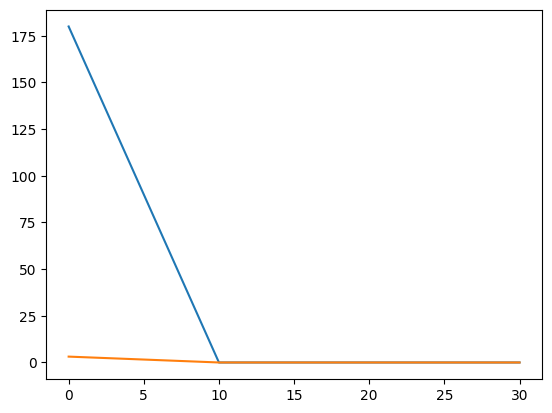

In [64]:
tr = np.array(trajectory)
theta = tr[0,:] * 180 / np.pi
x_dot = tr[3,:]

from matplotlib import pyplot as plt

t = np.linspace(0,30,np.size(theta))

plt.plot(t, theta, t, x_dot)

### Run the animation to finalize your results

In [8]:
%%capture
animation = animator.get_animation()
# animation.save("1.gif")

In [9]:
animation # <--- 1-2 minutes to render

## Task 2: Adaptive Controller (60 points)

---------
Add friction into $\ddot{x}$ as follows:
```python
Dstate[3] = ... - c * sign(x_dot) * x_dot^2 ### Here you can assign to "c" any positive value
 ```
 Design and test an adaptive controller so that parameter `c` is defined inside the system while not being available to controller.
 
 Stick to the following plan:

 1. Implement new system
 2. Implement adaptive block, which yields a new estimation of the unknown parameter
 3. Modify existing controller by inserting an adaptation block and test it

In [51]:
class CartPoleWithFriction(CartPole):

    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.name = "2wrobot"

    def compute_dynamics(self, time, state, action, disturb=None):
        Dstate = utilities.rc.zeros(
            self.dim_state,
            prototype=(state, action),
        )

        m_c, m_p, g, l = self.pars
        theta = state[0]
        theta_dot = state[2]
        x_dot = state[3]

        ####################
        #YOUR CODE GOES HERE
        ####################


        F=action[0]
        
        c=0.1
        
        x2dot= (-m_p*g*np.cos(theta)*np.sin(theta)+m_p*l*np.power(theta_dot,2)*np.sin(theta)+F)/(
            m_c+m_p*np.power(np.sin(theta),2)
        )
        theta2dot=g/l*np.sin(theta)-x2dot*np.cos(theta)/l

        Dstate[0]=theta_dot
        Dstate[1]=x_dot
        Dstate[2]=theta2dot 
        Dstate[3]=x2dot - c * np.sign(x_dot) * np.power(x_dot, 2)


        ####################
        #YOUR CODE ENDS HERE
        ####################

        return Dstate

    def out(self, state, time=None, action=None):
        theta = state[0]
        x = state[1]
        theta_dot = state[2]
        x_dot = state[3]
        theta_observed = theta
        theta_observed = theta - utilities.rc.floor(theta / (2 * np.pi)) * 2 * np.pi
        if theta_observed > np.pi:
            theta_observed = theta_observed - 2 * np.pi

        return utilities.rc.array([theta_observed, x, theta_dot, x_dot])

### To implement the adaptation block you have to

1. Derive the parameter estimation derivative
2. Implement integration step to obtain the next estimate of parameter `c` (we suggest to use Euler integration scheme)

In [52]:
class AdaptationBlockCartpole(AdaptationBlock):
    def __init__(self, c_hat_init, step_size, system=None):
        self.c_hat_init = c_hat_init
        self.current_c_hat = c_hat_init
        self.step_size = step_size
        self.system = system
        self.m_c, self.m_p, self.g, self.l = system.pars

    def euler_step(self, current_state):
        
        ####################
        #YOUR CODE GOES HERE
        ####################
        self.current_c_hat += self.step_size * self.parameter_estimation_derivative(
            current_state
        )
        ####################
        #YOUR CODE ENDS HERE
        ####################

        return self.current_c_hat

    def get_parameter_estimation(self, current_state):
        ####################
        #YOUR CODE GOES HERE
        ####################

        self.current_c_hat = self.euler_step(current_state)
        
        if(self.current_c_hat < 0):
            self.current_c_hat=0 
        ####################
        #YOUR CODE ENDS HERE
        ####################
        return self.current_c_hat

    def parameter_estimation_derivative(self, current_state):
        theta = current_state[0]
        x = current_state[1]
        theta_dot = current_state[2]
        x_dot = current_state[3]

        ####################
        #YOUR CODE GOES HERE
        ####################

        alpha=0.001

        
        E=(self.m_p*np.power(self.l,2)*np.power(theta_dot,2))/2 + self.m_p*self.g*self.l*(-np.cos(theta)+1)
        
        c_hat=alpha*E*self.m_p*self.l*theta_dot*np.cos(theta)*np.sign(x_dot)*np.power(x_dot,2)

        


        print('c_hat=', c_hat,'\n')
        
        ####################
        #YOUR CODE ENDS HERE
        ####################
        return c_hat

In [53]:
class ControllerCartPoleEnergyBasedAdaptive(ControllerCartPoleEnergyBased):
    def __init__(self, *args, adaptation_block=None, **kwargs):
        super().__init__(*args, **kwargs)
        self.adaptation_block = adaptation_block

    def compute_action(self, state, observation, **kwargs):
        theta, x, theta_dot, x_dot = (
            observation[0],
            observation[1],
            observation[2],
            observation[3],
        )
        
        c = self.adaptation_block.get_parameter_estimation(state)
  
        print('c=',c,"\n")
        ####################
        #YOUR CODE GOES HERE
        ####################

        k=1
    
        E=(self.m_p*np.power(self.l,2)*np.power(theta_dot,2))/2 + self.m_p*self.g*self.l*(np.cos(theta)-1)

        if(np.abs(theta_dot) < 1e-5):
            theta_dot = 0.01

        self.action[0]=2*self.g*np.sin(theta)/np.cos(theta)*(self.m_c+self.m_p*np.power(np.sin(theta),2))+\
                       self.m_p*self.g*np.cos(theta)*np.sin(theta)-\
                       self.m_p*self.l*np.power(theta_dot,2)*np.sin(theta)+\
                       k*E*theta_dot*np.cos(theta)+\
                       self.m_c+self.m_p*np.power(np.sin(theta),2)*c*np.sign(x_dot)*np.power(x_dot,2)
        print(f"Action = {self.action[0]:.3f}")

        ####################
        #YOUR CODE ENDS HERE
        ####################
        return self.action

## Testing part

In [54]:
system = CartPoleWithFriction(
    dim_input=1,
    dim_output=4,
    sys_type="diff_eqn",
    dim_state=4,
    dim_disturb=4,
    pars=[0.1, 2., 9.81, 0.5]
)
adaptation_block = AdaptationBlockCartpole(c_hat_init=0.5, step_size=0.001, system=system)

controller = ControllerCartPoleEnergyBasedAdaptive(
    action_bounds=rc.array([[-500, 500]]),
    time_start = 0,
    state_init=rc.array([np.pi, 0, 0, 0]),
    sampling_time = 0.0001,
    system=system,
    adaptation_block=adaptation_block
)

# scenario, animator = create_testing_pipeline(system, controller)

scenario, animator = create_testing_pipeline(
    system, 
    controller, 
    state_init=state_init, 
    action_init=action_init, 
    model_of_running_objective = ModelQuadForm(weights=np.diag([5, 5, 0, 0, 0])),
    observation_namings=["x", "y", "angle"],
    action_namings=["lin. speed", "ang. speed"],
    system_visualization_dashboard=dashboard,
    system_visualization_dashboard_params={
        "time_start": 0, 
        "rod_length": 1
        },
    time_final=15,
    )

Passed datum_namings are not consistent with datum_init. Truncated.
Passed datum_namings are not consistent with datum_init. Truncated.


In [55]:
scenario.run() # <--- takes some time. In TA's solution not more that half the minute
trajectory = []
for i , (k, v) in enumerate(scenario.cache.items()):
    trajectory.append(v[3])

trajectory[-300::10]

c_hat= -7.816580383992123e-55 

c= 0.5 

Action = 0.296
c_hat= -7.654153498988201e-10 

c= 0.4999999999992346 

Action = 0.206
c_hat= -4.42158683455125e-09 

c= 0.49999999999481304 

Action = 0.290
c_hat= -1.7551924137909417e-08 

c= 0.49999999997726113 

Action = 0.401
c_hat= -6.040140985966928e-08 

c= 0.4999999999168597 

Action = 0.554
c_hat= -1.9058471403563518e-07 

c= 0.499999999726275 

Action = 0.766
c_hat= -5.689183250596187e-07 

c= 0.4999999991573567 

Action = 1.059
c_hat= -1.6368422198420057e-06 

c= 0.4999999975205145 

Action = 1.464
c_hat= -4.592498508132297e-06 

c= 0.499999992928016 

Action = 2.024
c_hat= -1.2662458954802467e-05 

c= 0.49999998026555703 

Action = 2.798
c_hat= -3.4488212650603824e-05 

c= 0.49999994577734436 

Action = 3.868
c_hat= -9.312434205920461e-05 

c= 0.4999998526530023 

Action = 5.344
c_hat= -0.00024991197717334865 

c= 0.4999996027410251 

Action = 7.379
c_hat= -0.0006677602492014717 

c= 0.4999989349807759 

Action = 10.180
c_hat= -0.001

C:\Users\serge\AppData\Local\Temp\ipykernel_8368\2710378304.py:32: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if self.action_bounds != []:


c_hat= -0.2023212776841493 

c= 0.3240167525612752 

Action = -3.359
c_hat= -0.20626385823253654 

c= 0.3238104887030427 

Action = -3.369
c_hat= -0.21023585362244887 

c= 0.32360025284942023 

Action = -3.380
c_hat= -0.214236635901008 

c= 0.3233860162135192 

Action = -3.390
c_hat= -0.21826557230883498 

c= 0.32316775064121034 

Action = -3.401
c_hat= -0.22232202537065746 

c= 0.3229454286158397 

Action = -3.411
c_hat= -0.22640535295955683 

c= 0.32271902326288016 

Action = -3.422
c_hat= -0.23051490833597693 

c= 0.3224885083545442 

Action = -3.432
c_hat= -0.23465004016267152 

c= 0.3222538583143815 

Action = -3.443
c_hat= -0.23881009249681348 

c= 0.3220150482218847 

Action = -3.453
c_hat= -0.24299440476053652 

c= 0.32177205381712415 

Action = -3.464
c_hat= -0.24720231169120563 

c= 0.3215248515054329 

Action = -3.474
c_hat= -0.2514331432727407 

c= 0.32127341836216017 

Action = -3.485
c_hat= -0.2556862246493356 

c= 0.32101773213751084 

Action = -3.495
c_hat= -0.259960876

[array([  6.29538517, -47.04545562,   0.24953962,  -3.0989136 ]),
 array([  6.2977678 , -47.0763342 ,   0.22694472,  -3.07676463]),
 array([  6.29992303, -47.10699011,   0.20406133,  -3.05438538]),
 array([  6.30184803, -47.1374212 ,   0.18089957,  -3.03180365]),
 array([  6.30354007, -47.16762558,   0.15747077,  -3.00904796]),
 array([  6.30499655, -47.19760165,   0.13378822,  -2.98614787]),
 array([  6.306215  , -47.22734813,   0.10986785,  -2.96313432]),
 array([  6.30719314, -47.25686405,   0.08572886,  -2.94003995]),
 array([  6.3079289 , -47.28614877,   0.06139427,  -2.91689932]),
 array([ 6.30842045e+00, -4.73152020e+01,  3.68915095e-02, -2.89374919e+00]),
 array([ 6.30866626e+00, -4.73440238e+01,  1.22528035e-02, -2.87062866e+00]),
 array([ 6.30866517e+00, -4.73726148e+01, -1.24843941e-02, -2.84757937e+00]),
 array([ 6.30841639e+00, -4.74009758e+01, -3.72771306e-02, -2.82464557e+00]),
 array([  6.30791962, -47.42910826,  -0.06207677,  -2.80187414]),
 array([  6.30717504, -47.45

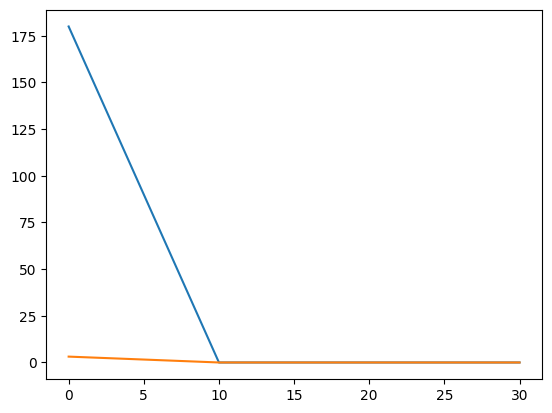

In [63]:
tr = np.array(trajectory)
theta = tr[0,:] * 180 / np.pi
x_dot = tr[3,:]

from matplotlib import pyplot as plt

t = np.linspace(0,30,np.size(theta))

plt.plot(t, theta, t, x_dot)

In [56]:
%%capture
animation = animator.get_animation()
# animation.save('2.gif')


In [57]:
animation